In [1]:
# useful imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [2]:
'''
Reading in the dataset
'''
df = pd.read_csv("C:\\Users\\Alan\\Documents\\GitHub\\dsc190-wi21\\fp\\data.csv")

In [3]:
'''
Each row is a song on Spotify
'''
print(f"There are {df.shape[0]} songs in the data, and {df.shape[1]} features per song")
df.head()
df.tail()

There are 174389 songs in the data, and 19 features per song


,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
174384,0.00917,"['DJ Combo', 'Sander-7', 'Tony T']",0.792,147615,0.866,0,46LhBf6TvYjZU2SMvGZAbn,0.00006,6,0.178,-5.089,0,The One,0,2020-12-25,0.0356,125.972,0.186,2020
174385,0.79500,['Alessia Cara'],0.429,144720,0.211,0,7tue2Wemjd0FZzRtDrQFZd,0.00000,4,0.196,-11.665,1,A Little More,0,2021-01-22,0.0360,94.710,0.228,2021
174386,0.80600,['Roger Fly'],0.671,218147,0.589,0,48Qj61hOdYmUCFJbpQ29Ob,0.92000,4,0.113,-12.393,0,Together,0,2020-12-09,0.0282,108.058,0.714,2020
174387,0.92000,['Taylor Swift'],0.462,244000,0.240,1,1gcyHQpBQ1lfXGdhZmWrHP,0.00000,0,0.113,-12.077,1,champagne problems,69,2021-01-07,0.0377,171.319,0.320,2021
174388,0.23900,['Roger Fly'],0.677,197710,0.460,0,57tgYkWQTNHVFEt6xDKKZj,0.89100,7,0.215,-12.237,1,Improvisations,0,2020-12-09,0.0258,112.208,0.747,2020


In [4]:
'''
Datatype inspection
'''
print(f"The datatypes of each feature: \n{df.dtypes}")

The datatypes of each feature: 
acousticness        float64
artists              object
danceability        float64
duration_ms           int64
energy              float64
explicit              int64
id                   object
instrumentalness    float64
key                   int64
liveness            float64
loudness            float64
mode                  int64
name                 object
popularity            int64
release_date         object
speechiness         float64
tempo               float64
valence             float64
year                  int64
dtype: object


In [5]:
'''
Null value inspection
No null values are present
'''
print(f"Null values per feature: \n{df.isnull().apply(sum)}")

Null values per feature: 
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
valence             0
year                0
dtype: int64


In [6]:
'''
Sample statistics
The bounds for most audio parameters are 0 to 1, interestingly there is at least one song where Spotify estimated the tempo as zero
The median year between 1920 and 2020 is 1970, however the mean year for a song on Spotify is 1977, implying that newer songs are better represented on Spotify
'''
print(f"{df.describe()}")

        acousticness   danceability   duration_ms         energy  \
count  174389.000000  174389.000000  1.743890e+05  174389.000000   
mean        0.499228       0.536758  2.328100e+05       0.482721   
std         0.379936       0.176025  1.483958e+05       0.272685   
min         0.000000       0.000000  4.937000e+03       0.000000   
25%         0.087700       0.414000  1.661330e+05       0.249000   
50%         0.517000       0.548000  2.057870e+05       0.465000   
75%         0.895000       0.669000  2.657200e+05       0.711000   
max         0.996000       0.988000  5.338302e+06       1.000000   

            explicit  instrumentalness            key       liveness  \
count  174389.000000     174389.000000  174389.000000  174389.000000   
mean        0.068135          0.197252       5.205305       0.211123   
std         0.251978          0.334574       3.518292       0.180493   
min         0.000000          0.000000       0.000000       0.000000   
25%         0.000000       

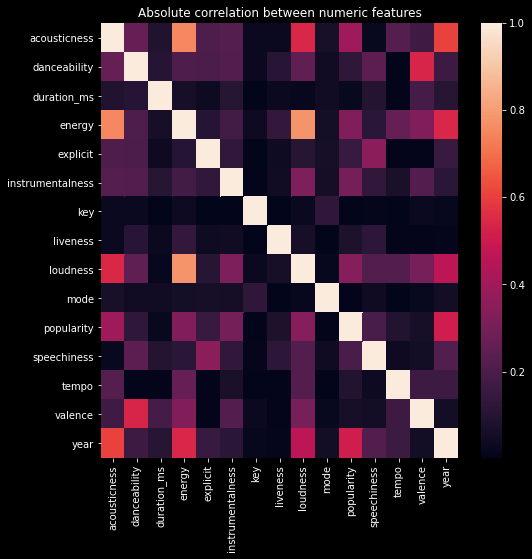

In [7]:
corr_matrix = np.abs(pd.DataFrame(
    df, df.index, df.columns[df.dtypes != 'object']).corr())
fig, ax = plt.subplots(figsize=(8, 8))
sns.heatmap(corr_matrix)
plt.title("Absolute correlation between numeric features")
plt.show()

In [8]:
print(f"Correlation of numeric features with population: \n{np.abs(corr_matrix['popularity']).sort_values(ascending=False)}")

Correlation of numeric features with population: 
popularity          1.000000
year                0.513227
acousticness        0.396744
loudness            0.337194
energy              0.328939
instrumentalness    0.300625
speechiness         0.195329
explicit            0.152545
danceability        0.123746
tempo               0.094985
liveness            0.078959
valence             0.063471
duration_ms         0.024717
mode                0.007652
key                 0.001951
Name: popularity, dtype: float64


In [9]:
print(f"Number of unique artists: {df['artists'].nunique()}")
print(f"Mean number of songs per artist: {df['artists'].value_counts().mean()}")

Number of unique artists: 36195
Mean number of songs per artist: 4.818041165906894


In [10]:
df['number_of_songs_by_artist'] = df['artists'].map(
    df['artists'].value_counts())
df['artist_popularity'] = df['artists'].map(
    df.groupby('artists')['popularity'].mean())
corr_matrix = np.abs(pd.DataFrame(
    df, df.index, df.columns[df.dtypes != 'object']).corr())
print(
    f"Correlation of numeric features with population: \n{np.abs(corr_matrix['popularity']).sort_values(ascending=False)}")
'''
Artist popularity has a high correlation with the popularity of the song, as expected
'''

Correlation of numeric features with population: 
popularity                   1.000000
artist_popularity            0.922699
year                         0.513227
acousticness                 0.396744
loudness                     0.337194
energy                       0.328939
instrumentalness             0.300625
speechiness                  0.195329
number_of_songs_by_artist    0.182438
explicit                     0.152545
danceability                 0.123746
tempo                        0.094985
liveness                     0.078959
valence                      0.063471
duration_ms                  0.024717
mode                         0.007652
key                          0.001951
Name: popularity, dtype: float64


'\nArtist popularity has a high correlation with the popularity of the song, as expected\n'

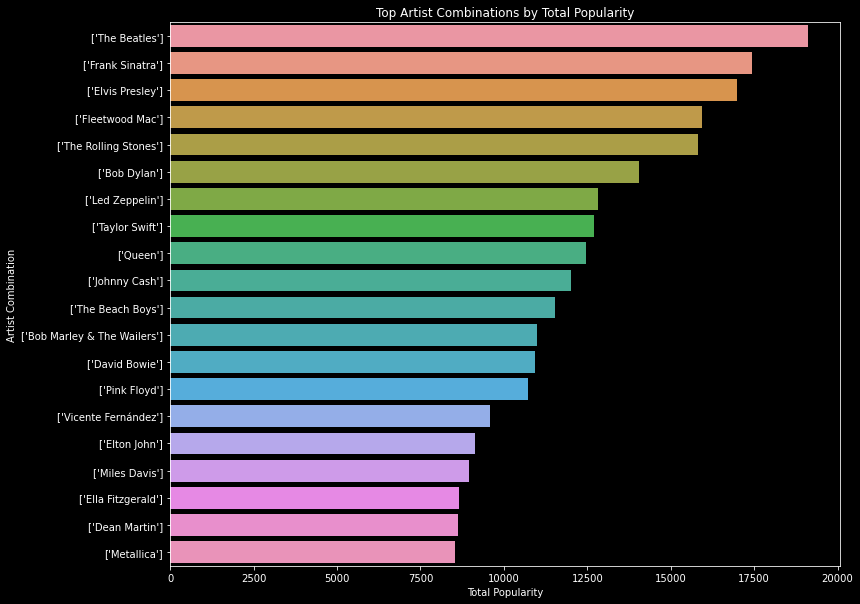

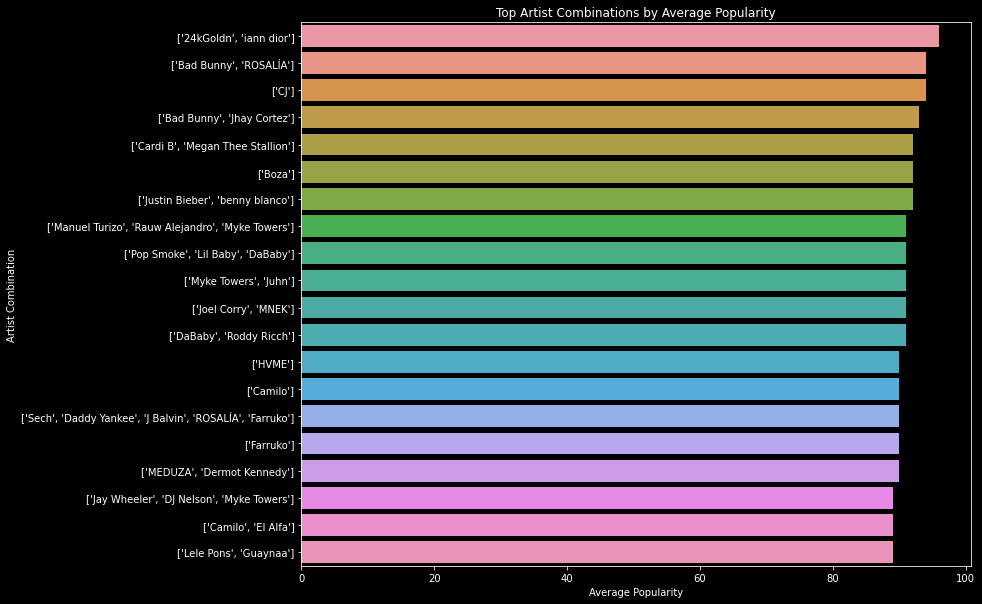

In [15]:
'''
When measured by total popularity, the top artists consist of solo acts, because solo acts tend to produce more music which contributes more to the sum of popularity
Looking at average popularity, groups of multiple artists are dominant
'''
top_lists = [df.groupby('artists')['popularity'].sum().sort_values(ascending=False).head(20), df.groupby('artists')['popularity'].mean().sort_values(ascending=False).head(20)]
for i, top_combos in enumerate(top_lists):
    fig, axis = plt.subplots(figsize = (12, 10))
    axis = sns.barplot(x=top_combos.values, y=top_combos.index, orient="h", ax=axis)
    xlab = 'Total Popularity' if i == 0 else 'Average Popularity'
    title = 'Top Artist Combinations by Total Popularity' if i == 0 else 'Top Artist Combinations by Average Popularity'
    axis.set_xlabel(xlab)
    axis.set_ylabel('Artist Combination')
    axis.set_title(title)
    plt.show()

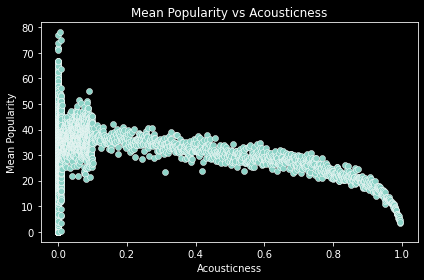

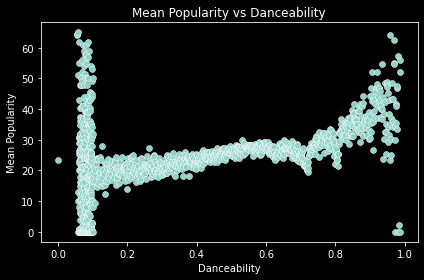

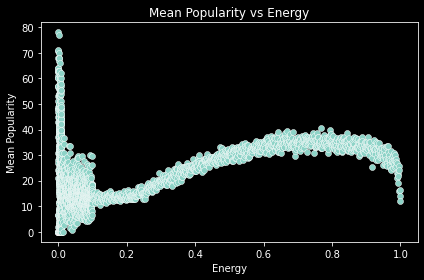

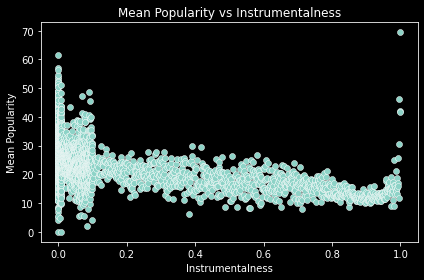

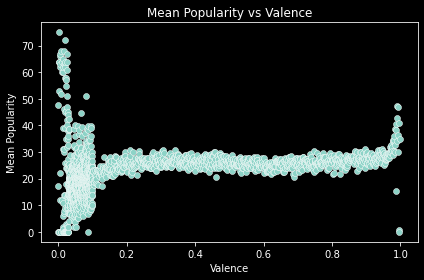

...

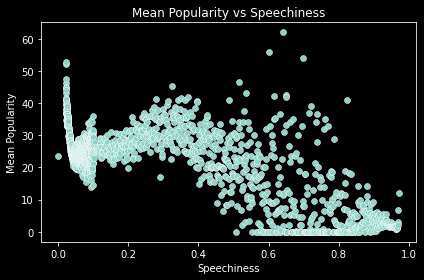

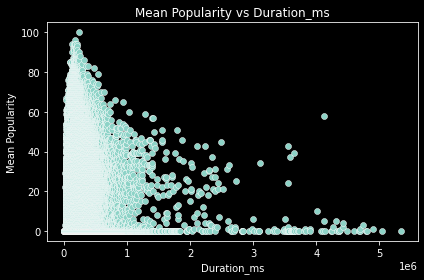

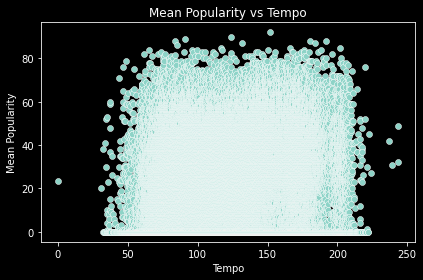

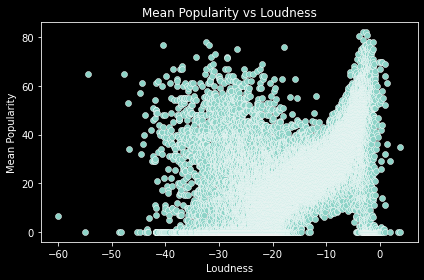

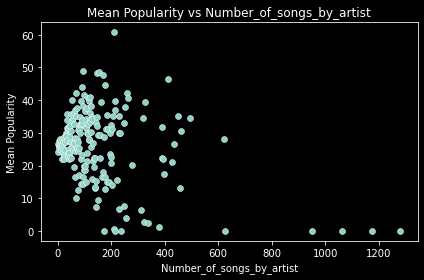

In [33]:
numeric_cols = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'valence',
                'liveness', 'speechiness', 'duration_ms', 'tempo', 'loudness', 'number_of_songs_by_artist']
for feat in numeric_cols:
        fig, axis = plt.subplots()
        feat_group =  df.groupby(feat)['popularity'].mean().to_frame().reset_index()
        axis = sns.scatterplot(feat_group[feat], feat_group['popularity'], ax=axis)
        axis.set_title(f'Mean Popularity vs {feat.capitalize()}')
        axis.set_ylabel('Mean Popularity', fontsize=10)
        axis.set_xlabel(feat.capitalize(), fontsize=10)
        plt.tight_layout()
        plt.show()


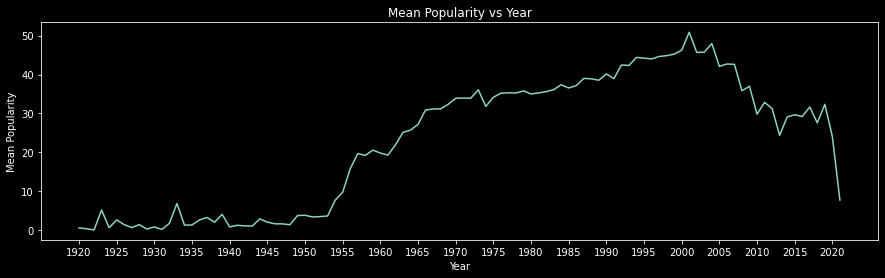

In [34]:
'''
Mean popularity of songs over time
'''
fig, axis = plt.subplots(figsize=(15, 4))
axis = df.groupby('year')['popularity'].mean().plot()
axis.set_title('Mean Popularity vs Year')
axis.set_ylabel('Mean Popularity')
axis.set_xlabel('Year')
axis.set_xticks(range(1920, 2021, 5))
plt.show()